In [1]:
import pandas as pd
import altair as alt
alt.renderers.enable("mimetype")
from vega_datasets import data
import warnings
warnings.filterwarnings('ignore')

In [2]:
movies_url = data.movies.url
movies = pd.read_json(movies_url)
movies.shape

(3201, 16)

In [3]:
movies.head()

,Title,US_Gross,Worldwide_Gross,US_DVD_Sales,Production_Budget,Release_Date,MPAA_Rating,Running_Time_min,Distributor,Source,Major_Genre,Creative_Type,Director,Rotten_Tomatoes_Rating,IMDB_Rating,IMDB_Votes
0,The Land Girls,146083.0,146083.0,NaN,8000000.0,Jun 12 1998,R,NaN,Gramercy,None,None,None,None,NaN,6.1,1071.0
1,"First Love, Last Rites",10876.0,10876.0,NaN,300000.0,Aug 07 1998,R,NaN,Strand,None,Drama,None,None,NaN,6.9,207.0
2,I Married a Strange Person,203134.0,203134.0,NaN,250000.0,Aug 28 1998,None,NaN,Lionsgate,None,Comedy,None,None,NaN,6.8,865.0
3,Let's Talk About Sex,373615.0,373615.0,NaN,300000.0,Sep 11 1998,None,NaN,Fine Line,None,Comedy,None,None,13.0,NaN,NaN
4,Slam,1009819.0,1087521.0,NaN,1000000.0,Oct 09 1998,R,NaN,Trimark,Original Screenplay,Drama,Contemporary Fiction,None,62.0,3.4,165.0


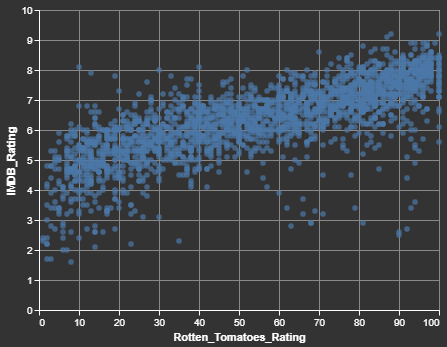

In [4]:
# Erst mal ein Blick in dei Daten werfen
alt.Chart(movies).mark_circle().encode(
    alt.X("Rotten_Tomatoes_Rating:Q"),
    alt.Y("IMDB_Rating:Q"),
    alt.Tooltip("Title:N")
)

## Aggregate Transform

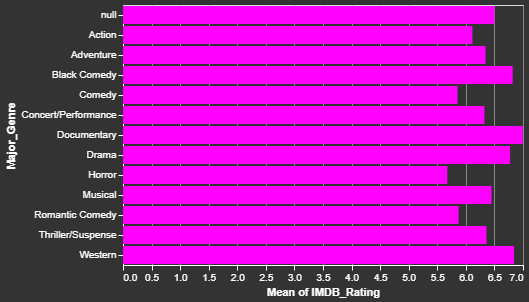

In [5]:
# Altait kann Daten on the fly aggregieren
alt.Chart(movies).mark_bar(color="magenta").encode(
    alt.X("mean(IMDB_Rating):Q"),
    alt.Y("Major_Genre:N")
)

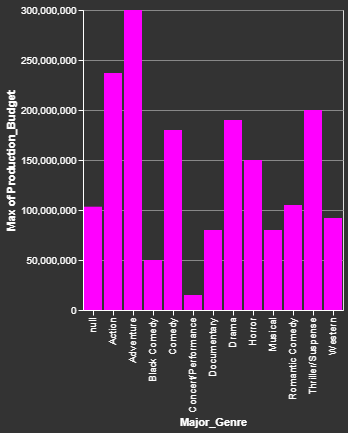

In [6]:
alt.Chart(movies).mark_bar(color="magenta").encode(
    alt.X("Major_Genre:N"),
    alt.Y("max(Production_Budget):Q"),
    tooltip = "max(Production_Budget):Q" # geht auch für Tooltip .-)

)

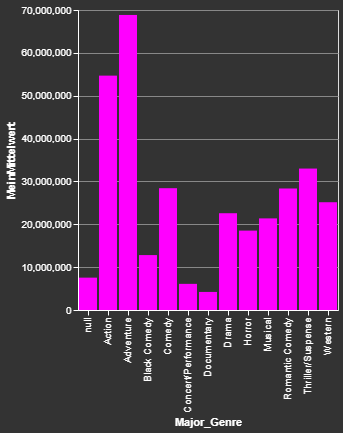

In [7]:
# Ausführlich (aber für den Mittelwert) -> vorteilhaft, wenn viele Teile des Charts auf die neue Variable zugreifen
alt.Chart(movies).mark_bar(color="magenta").encode(
    alt.X("Major_Genre:N"),
    alt.Y("MeinMittelwert:Q"),
    tooltip = "MeinMittelwert:Q" # geht auch für Tooltip .-)
).transform_aggregate(
    MeinMittelwert = "mean(Production_Budget)",
    groupby=["Major_Genre"]
)

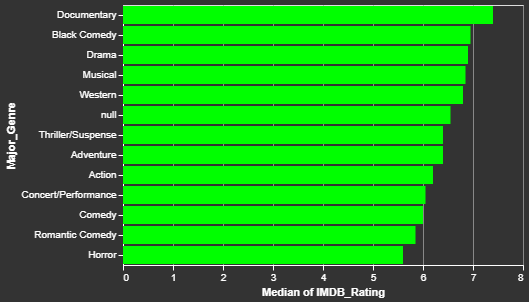

In [8]:
# sortieren
alt.Chart(movies).mark_bar(color="lime").encode(
    alt.X("median(IMDB_Rating):Q"),
    alt.Y("Major_Genre:N", 
          sort= alt.EncodingSortField(
                op="median",
                field= "IMDB_Rating",
                order="descending"
                )
        )
)

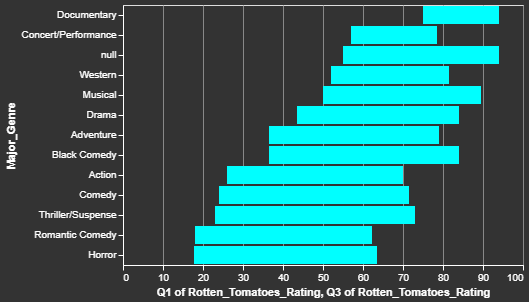

In [9]:
# IQR
alt.Chart(movies).mark_bar(color="aqua").encode(
    alt.X("q1(Rotten_Tomatoes_Rating):Q"),
    alt.X2("q3(Rotten_Tomatoes_Rating):Q"),
    alt.Y("Major_Genre:N", 
          sort= alt.EncodingSortField(
                op="q1",
                field= "Rotten_Tomatoes_Rating",
                order="descending"
                )
        )
)

## Bin Transform

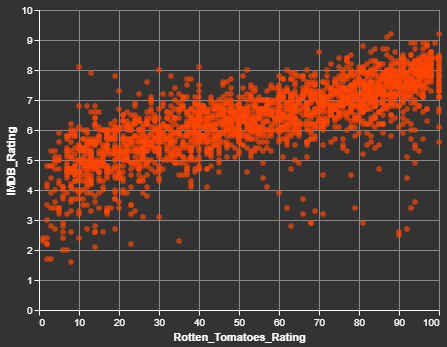

In [10]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q"),
    alt.Y("IMDB_Rating:Q")
)

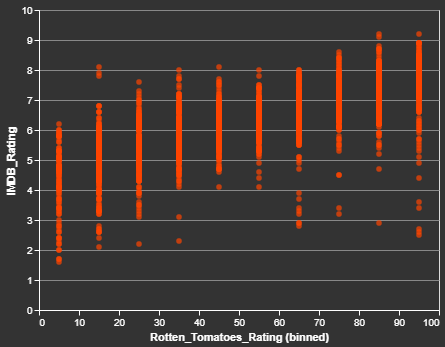

In [11]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=True),
    alt.Y("IMDB_Rating:Q")
)

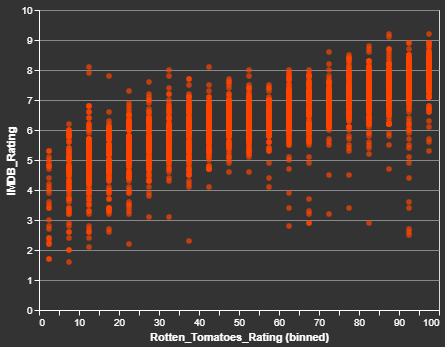

In [12]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("IMDB_Rating:Q")
)

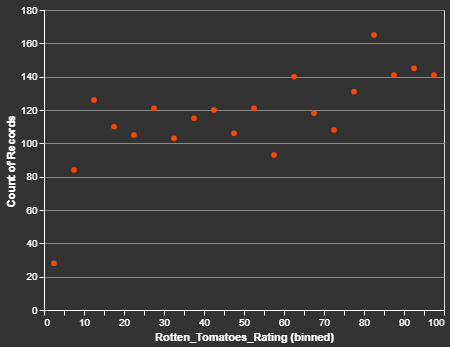

In [13]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("count()")
)

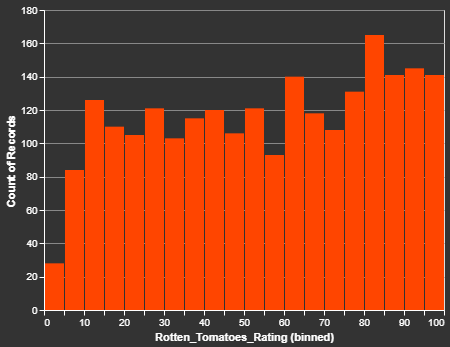

In [14]:
# Histogram
alt.Chart(movies).mark_bar(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("count()")
)

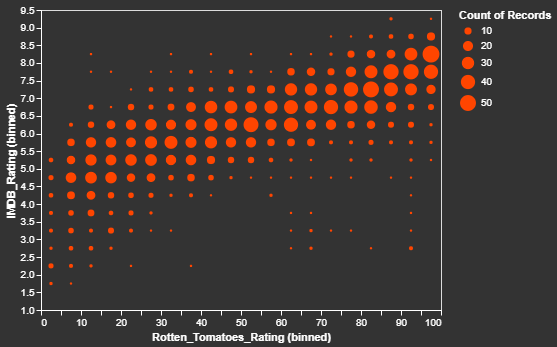

In [15]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("IMDB_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Size("count()")
)

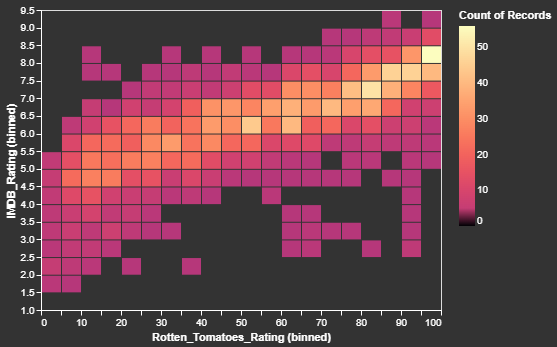

In [16]:
alt.Chart(movies).mark_bar().encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=40)),
    alt.Y("IMDB_Rating:Q", bin=alt.BinParams(maxbins=30)),
    alt.Color("count()", scale=alt.Scale(domainMid=0, scheme='magma')) #https://vega.github.io/vega/docs/schemes/#diverging 
)

## TimeUnit Transforms

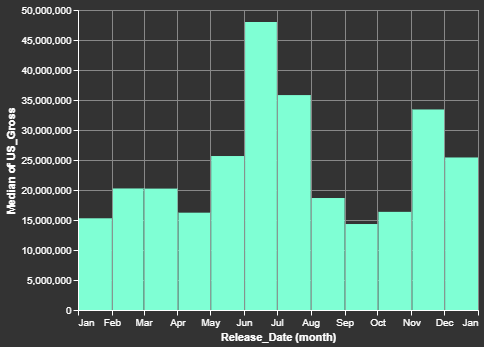

In [17]:
alt.Chart(movies).mark_bar(color="Aquamarine").encode(
    alt.X("month(Release_Date):T"),
    alt.Y("median(US_Gross):Q")
)

## Calculate Transforms

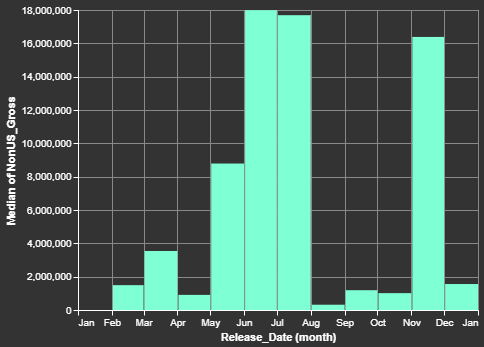

In [18]:
# Alternative (wie alles) zum Transformieren in Pandas
alt.Chart(movies).mark_bar(color="Aquamarine").encode(
    alt.X("month(Release_Date):T"),
    alt.Y("median(NonUS_Gross):Q")
).transform_calculate(
    NonUS_Gross= "datum.Worldwide_Gross - datum.US_Gross"
)

# Filter

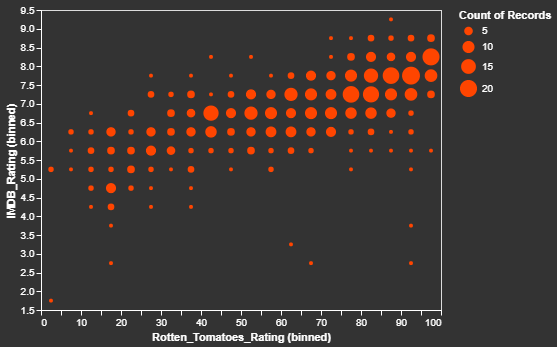

In [19]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("IMDB_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Size("count()")
).transform_filter("datum.Major_Genre == 'Drama'")

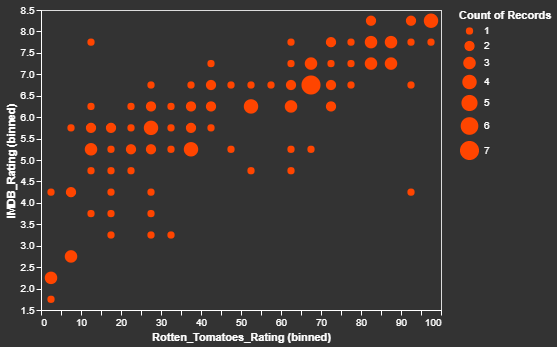

In [20]:
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("IMDB_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Size("count()")
).transform_filter("year(datum.Release_Date) > 2005").transform_filter("datum.Major_Genre == 'Comedy'") 

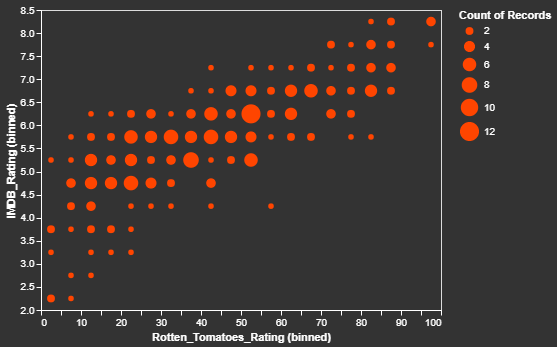

In [21]:
# geht auch mit & verknüpfung in einer Methode
alt.Chart(movies).mark_circle(color="OrangeRed").encode(
    alt.X("Rotten_Tomatoes_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Y("IMDB_Rating:Q", bin=alt.BinParams(maxbins=20)),
    alt.Size("count()")
).transform_filter(
    (alt.datum.Production_Budget > 20000000) &
    (alt.datum.Major_Genre == 'Comedy') 
)